# Basement topography and sediment thickness beneath Antarctica's Ross Ice Shelf

Follow along this Jupyter notebook to see the code behind the analysis and figures for Tankersley et al., 2022. This notebook, and much of the data used are located in a github repository (https://github.com/mdtanker/RIS_basement_sediment), as well as being hosted on PANGAEA (https://doi.pangaea.de/10.1594/PANGAEA.941238).

Please let me know if you have any questions. Thanks to Matt Siegfried for providing a template for figure creation in PyGMT, from Venturelli et al., 2020.

*Matt Tankersley*  
*Antarctic Research Centre, Victoria University of Wellington, NZ*  
*matthew.tankersley@vuw.ac.nz*  
*20 March, 2022*

Tankersley, M. D., Horgan, H. J., Siddoway, C. S., Caratori Tontini, F., & Tinto, K. J. (2022).  
Basement topography and sediment thickness beneath Antarctica’s Ross Ice Shelf. _Geophysical Research Letters._

In [1]:
# import necessary python packages
import pygmt
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import gridspec
import copy
import scipy.interpolate 
import itertools
import matplotlib.animation
import random

import os

In [2]:
# all file paths assume this notebook is in /RIS_basement_sediment
os.getcwd()

'C:\\Users\\matthewt\\Documents\\Python_Scripts\\RIS_basement_sediment'

## Datasets

All the data used in this notebook and the figures accompanying this paperis publically available. Some of it is in in the \Data folder of the github repository where this notebook was downloaded from: https://github.com/mdtanker/RIS_basement_sediment

The following datasets will need to be downloaded from the respective URL's and added the "Data\Download" folder.
* BedMachine bathymetry (Morlighem et al., 2020. https://doi.org/10.1038/s41561-019-0510-8)
    - https://nsidc.org/data/NSIDC-0756/versions/2
* MEaSUREs grounding line and coastline (Rignot et al., 2013. https://doi.org/10.1126/science.1235798)
    - https://nsidc.org/data/nsidc-0709
* MODIS-MOA satellite imagery (Scambos et al., 2007. https://doi.org/10.1016/j.rse.2006.12.020)
    - https://nsidc.org/data/NSIDC-0593
    - get geotiff "moa750_2009_hp1_v02.0.tif"
* ANTOSTRAT seismic basement depths (Brancolini et al., 1995. https://doi.org/10.1002/9781118669013.app1)
    - we use a sediment thickness compilation which included ANTOSTRAT data (Lindeque et al. 2016., https://doi.org/10.1002/2016GC006401), and subtract it from BedMachine bathymetry to get basement. 
* ROSETTA-Ice airborne magnetics data (Tinto et al., 2019. https://doi.org/10.1038/s41561-019-0370-2)
    - https://pgg.ldeo.columbia.edu/data/rosetta-ice
* OIB airborne magnetics data (Cochran et al. 2014, https://doi.org/10.5067/OY7C2Y61YSYW)
    - Flight 403: "IMCS31B_V02_20112013_A.csv"
    - Flight 404: "IMCS31B_V02_25112013_A.csv"

## To start off, lets recreate Figure 1 of our paper:
To do this, we need to change directories into the /Figures folder, and run the jupyter notebook "Fig1_Bathy_Mag.ipynb".

In [3]:
os.chdir('Figures')
os.getcwd()

'C:\\Users\\matthewt\\Documents\\Python_Scripts\\RIS_basement_sediment\\Figures'

In [4]:
%run Fig1_Bathy_Mag.ipynb

C:\Users\matthewt\AppData\Local\Temp\ipykernel_33212\3348201746.py:7: DtypeWarning: Columns (6,24) have mixed types. Specify dtype option on import or set low_memory=False.
  df_rs = pd.read_csv(ROSETTA, header=0,index_col=None,sep=',')
C:\Users\matthewt\AppData\Local\miniforge3\envs\pygmt06\lib\site-packages\geopandas\io\file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,
C:\Users\matthewt\AppData\Local\miniforge3\envs\pygmt06\lib\site-packages\geopandas\io\file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,
gmtset [WARNING]: Representation of font type not recognized. Using default.
C:\Users\matthewt\AppData\Local\miniforge3\envs\pygmt06\lib\site-packages\geopandas\io\file.py:362: FutureWarning: pandas.Int64Index is deprecated

Now lets change back to the folder \RIS_basement_sediment

In [ ]:
os.chdir('..')
os.getcwd()

# Depth to magnetic basement process
Figure 1 shows the location, important landmarks, and the input datasets used in this study. Our research area is the Ross Ice Shelf, shown on the right panel as the area with magnetics data. This magnetics data is from the ROSETTA-Ice project, and is our main dataset. Also shown in the right panel are Operation Ice Bridge (OIB) airborne magnetics data (dotted black lines and 2 colored lines) and ANTOSTRAT seismic basement depths in the Ross Sea. 

We begin by estimating magnetic basement for OIB flight 403 in the Ross Sea. Our method to determine basement depths has a series of free parameters. We calculated basement depths with a wide range of values for each these parameters, and chose the set of values which results in the closest fit to ANTOSTRAT seismic basment. 

To determine magnetic basement depths, we use Werner deconvolution, which passes moving and expanding windows of magnetic anomaly line data, and solves the anomalies within each window for source parameters, such as distance along profile, depth, magnetic susceptibilty, body widy, and body geometry. This process is done in the geophysical software *Geosoft Oasis Montaj*. The exported csv from Geosoft is import here, where our filtering and clustering method turns scattered basement solutions into 2D basement depths. 


### 1) import Werner deconvolution solutions from Geosoft Oasis Montaj

In [3]:
# import geosoft .csv with Werner solutions for OIB line 403, 404, and ROSETTA lines
file_in = 'data\input\RIS123_1Hz_intermediate_Werner_2021_500_to_50k.csv'
df0 = pd.read_csv(file_in, header=0,index_col=None,sep=',')

# put line numbers into float format (L200 -> 200)
if type(df0.Line[0]) == str:
    df0.Line = df0.Line.str[1:]
df0['Line'] = pd.to_numeric(df0['Line']) 

# make dike solution depths be relative to sea level
# was relative to upwards continued flight elevation (1000masl)
df0['Depth'] = df0.Z_Dikes+1000

# if solutions are shallower then bathymetry, set equal to bathymetry
df0.Depth = np.where(df0.Depth>df0.bedmap2_bed, df0.bedmap2_bed, df0.Depth)  

# copy df to retain magnetics data to use in plotting
df_mag=copy.deepcopy(df0)

# drop columns and NaNs for oib dataset
df0_oib=df0.drop(df0.columns.difference(['Line','Distance','x','y','ANTOSTRAT_basement',
                                         'bedmap2_bed','Susc','Window_Width','Depth']), axis=1)
df0_oib.dropna(how='any', subset=('Line','Distance','x','y','Susc','Window_Width','Depth'), inplace=True)

# drop columns and NaNs for rosetta dataset
df0_rs=df0.drop(df0.columns.difference(['Line','Distance','x','y','bedmap2_bed', 
                                        'Susc','Window_Width','Depth']), axis=1)
df0_rs.dropna(how='any', subset=('Line','Distance','x','y','Susc','Window_Width','Depth'), inplace=True)

print(df0_oib.head())

     Line  ANTOSTRAT_basement  bedmap2_bed     Distance      Susc  \
4   403.1                 NaN  -640.123787   418.271576  0.312645   
30  403.1        -2097.348018  -646.556423  3596.459961  3.384511   
39  403.1        -2120.043582  -646.780432  4410.706055  4.445774   
46  403.1        -2127.171328  -646.817150  4670.665527  0.521187   
51  403.1        -2139.390477  -646.883734  5120.137695  1.575134   

    Window_Width              x             y        Depth  
4    1883.958059 -429877.501956 -1.349884e+06 -2008.287109  
30   9419.790292 -426754.604562 -1.350473e+06 -4372.663086  
39   8163.818253 -425957.292887 -1.350638e+06 -5183.338379  
46   1883.958059 -425703.423640 -1.350694e+06 -1772.488037  
51   5651.874176 -425265.011274 -1.350793e+06 -3175.393555  


### 2) define function to turn solutions into continuous 2D basement depth
* filter solutions based on their magnetic susceptibilty (parameter S) and Werner window width (paremeter W)
* horizontally bin the points, removing bins with less than specified minumum amount of filtered solutions (parameter C)
* interpolate line between these points
* compare depths for this line with ANTOSTRAT basement to get a mean misfit

In [4]:
# make function for filtering Werner solutions on susceptibilty & window width, and bins results
def filt_and_binning_oib(Line_oib, oib_parameter_s, oib_parameter_w, oib_parameter_b, oib_parameter_c):
    global mean_misfit, median_misfit, oib_filt_with_centers, oib, oib_mag, Distance_name, Depth_name, oib_filt, oib_bin_centers, df_oib_basement, oib_filt_with_centers
    
    # isolate an individual line
    oib = df0_oib[df0_oib.Line==Line_oib].copy()
    oib_mag = df_mag[df_mag.Line==Line_oib]

    # make sure ANTOSTRAT column is filled
    if Line_oib in [403.1, 403.3]:
        oib.ANTOSTRAT_basement.interpolate(method='linear', axis=0, inplace=True, limit_area='inside')
    else:
        pass
    
    # retain oib dataframe before filtering is applied
    oib_filt=copy.deepcopy(oib)

    """
    filter solutions based on susceptibility and window width
    add filtered solutions depths and distances to new columns
    i.e. Distance_36k and Depth_36k for iterations where b=36km
    """
    Distance_name = 'Distance_'+(str(int(oib_parameter_b/1000))+'k')
    Depth_name ='Depth_'+(str(int(oib_parameter_b/1000))+'k')
    oib_filt = pd.concat([oib_filt,pd.DataFrame(columns=[Distance_name, Depth_name])]) # add above columns to oib
    oib_filt[Distance_name] = np.floor(oib_filt.Distance[(oib_filt.Susc > oib_parameter_s) & 
                                                         (oib_filt.Window_Width < oib_parameter_w)]/oib_parameter_b)*oib_parameter_b 
    oib_filt[Depth_name] = oib_filt.Depth[(oib_filt.Susc > oib_parameter_s) & (oib_filt.Window_Width < oib_parameter_w)]
    if Line_oib in [403.1, 403.3]:
        oib_filt.dropna(inplace=True) # remove rows with NaNs
    else: 
        cols=oib_filt.loc[:, ~oib_filt.columns.isin(['ANTOSTRAT_basement'])].columns # all cols except ANTOSTRAT
        oib_filt.dropna(subset=cols, inplace=True) # remove rows with NaNs except for ANTOSTAT columns, since its all nans 

    # Set bin centers equal to 95% depth of solutions within bin
    def quant(x):
        return x.quantile(0.95)
    # new df with only binned points, with distances set to the center of the bins and depths set to 95% of all points within bins
    oib_bin_centers = oib_filt.groupby([Distance_name], as_index=False).agg({Depth_name: quant})
    oib_bin_centers['Distance'] = oib_bin_centers[Distance_name]+(oib_parameter_b/2)
    oib_bin_centers['binned']=1 # keep track of binned points

    # rename Depth_name column so oib_bin_centers can be merged
    oib_filt.rename(columns={Depth_name:'Depth_filtered'}, inplace=True)

    # add the binned solutions to oib_filt
    oib_filt_with_centers = oib_filt.set_index(['Distance', Distance_name]).join(oib_bin_centers.set_index(['Distance', Distance_name]), how='outer')
    oib_filt_with_centers.reset_index(inplace=True)
    oib_filt_with_centers.sort_values(['Distance'], inplace=True)
    #fill nan's in columns, except 'binned'
    for col in oib_filt_with_centers.columns:
        if col == 'binned':
            pass
        else:
            oib_filt_with_centers[col].interpolate(method='linear', limit_direction='both', inplace=True)    

    """
    retain only the bins which contain a minumum number (count) of points
    """
    # number of filtered points within each bin
    oib_filt_with_centers['counts'] = oib_filt_with_centers.groupby([Distance_name])['Depth_filtered'].transform('count')
    oib_bin_centers=oib_filt_with_centers[oib_filt_with_centers.binned.notna()]
    oib_bin_centers=oib_bin_centers[oib_bin_centers.counts>oib_parameter_c]
    
    """
    Compare OIB basement results with ANTOSTRAT basement results
    """
    try:
        # interpolate line between binned points for comparison with ANTOSTRAT
        x1 = min(oib_bin_centers.Distance)
        x2 = max(oib_bin_centers.Distance)
        increment = 5000  #sample every 5k for optimization, every 1km of uncertainty analysis
        Distance_new = np.arange(x1, x2, increment)  # creates array for distance to interpolate onto, 1 point every 5km
        window = int(30000/increment) # window size for filtering resulting interpolated line
        try:
            # define function which takes distance, and gives interpolated depths
            f = scipy.interpolate.interp1d(oib_bin_centers.Distance, oib_bin_centers[Depth_name], kind='quadratic', fill_value='extrapolate') 
            # apply function to new distance array
            oib_basement=f(Distance_new)  
            # add new distances and interpolated depth to dataframe
            oib_solutions=pd.DataFrame(data={'Distance':Distance_new, 'oib_basement':oib_basement})
            # smooth the interpolated depths with a rolling mean window 
            oib_solutions['oib_basement_filt'] = oib_solutions.oib_basement.rolling(window, center=True).mean()
            oib_solutions.sort_values(['Distance'], inplace=True)
            # add 'oib_basement' and 'oib_basement_filt' columns to database to get x, y, etc. 
            df_oib_basement=oib_filt_with_centers.set_index('Distance').join(oib_solutions.set_index('Distance'), how='outer')
            df_oib_basement.reset_index(inplace=True)
            df_oib_basement.sort_values(['Distance'], inplace=True)
            # fill nans in all columns except 'oib_basement_filt' to get x, y, etc. for interpolated basement line
            for col in df_oib_basement.columns:
                if col == 'oib_basement_filt':
                    pass
                else:
                    df_oib_basement[col].interpolate(method='linear', limit_area='inside', inplace=True)    
            # drop all rows except for interpolate basement line
            # df_oib_basement.dropna(inplace=True)
            df_oib_basement.dropna(subset=['oib_basement_filt'], inplace=True)
            # if solutions are shallower then bathymetry, set equal to bathymetry
            df_oib_basement['filt_clip'] = np.where(df_oib_basement.oib_basement_filt>df_oib_basement.bedmap2_bed,
                                                        df_oib_basement.bedmap2_bed, df_oib_basement.oib_basement_filt)
            """
            if OIB line 403, compare resulting interpolated line with coincident ANTOSTRAT basement 
            """
            if Line_oib in [403.1, 403.3]:
                df_oib_basement['misfit'] = df_oib_basement.ANTOSTRAT_basement - df_oib_basement.filt_clip 
                df_oib_basement['abs_misfit'] = np.abs(df_oib_basement.misfit)
                mean_misfit=df_oib_basement.abs_misfit.mean()
                median_misfit=df_oib_basement.abs_misfit.median()
            else:
                mean_misfit=np.nan
                median_misfit=np.nan
        except: 
            mean_misfit=np.nan
            median_misfit=np.nan
            df_oib_basement=[]  
        # if more than 2 solution per 100km than continue  
        if (len(oib_bin_centers))/((max(oib_filt_with_centers.Distance)-min(oib_filt_with_centers.Distance))/100_000)<2: 
            mean_misfit=np.nan 
            median_misfit=np.nan
        else: 
            pass
    except: 
        mean_misfit=np.nan
        median_misfit=np.nan
        df_oib_basement=[]  
    return mean_misfit

### 3) define function to plot the above results

In [5]:
"""
erase any leftover global variables from above function
"""
vars=('vars','mean_misfit','median_misfit','oib_filt_with_centers','oib','oib_mag','Distance_name',
      'Depth_name','oib_filt','oib_bin_centers','df_oib_basement',)
save_list = globals() # list of all variables
save_list = [k for k in save_list if k not in vars]# all variables except thos in vars
# #finally, clear all variables (except default and saved) with:
for name in dir():
    if name not in save_list:
        del globals()[name]
"""
matplotlib plotting function
"""
def plot_OIB(Line_oib, oib_parameter_s, oib_parameter_w, oib_parameter_b, oib_parameter_c, animation=False): 
    global fig
    # run above function with parameters
    filt_and_binning_oib(Line_oib, oib_parameter_s, oib_parameter_w, oib_parameter_b, oib_parameter_c)

    # initialize figure
    if animation==True:
        pass
    else:
        fig = plt.figure(facecolor='w')
    
    gs = gridspec.GridSpec(2,1, height_ratios=[3,1])
    ax0 = fig.add_subplot(gs[0])
    # vertical lines of bin size
    ax0.vlines(oib_filt_with_centers[Distance_name].unique(),ymin=-10000, ymax=0, 
               color='k', linewidth=1).set_alpha(.2)    
    
    # bedmap2 bathymetry
    ax0.plot(oib.Distance, oib.bedmap2_bed, c='mediumturquoise', 
             linewidth=1.5, label='Bathymetry')
    
    # OIB filtered solutions, scaled by Susc
    ax0.scatter(oib_filt.Distance, oib_filt.Depth, s = oib_filt.Susc*3, marker='o', 
                edgecolors='k', facecolors='none', linewidth=.8, label='Filtered solutions')
    
    # OIB Werner dike solutions 
    ax0.scatter(oib.Distance, oib.Depth, s = 1.5, marker='.', edgecolor='none', 
                facecolor='k', label='All solution')
    
    # ANTOSTRAT basement  
    if Line_oib in [403.1, 403.3]:
        ax0.plot(oib.Distance, oib.ANTOSTRAT_basement,  c='blue', 
                 linewidth=2, label='Seismic Basement')
    else:
        pass
    
    # interpolated OIB basement
    try:
        ax0.plot(df_oib_basement.Distance, df_oib_basement.filt_clip, 
         c='darkorange', label='Mag basement')   
    except:
        pass
    
    # binned OIB basement solutions
    ax0.scatter(oib_bin_centers.Distance, oib_bin_centers[Depth_name], marker='x', 
                c='orange', s=60, label='Binned solutions', zorder=15)
    
    # OIB magnetics  
    ax1 = fig.add_subplot(gs[1], sharex=ax0)
    ax1.scatter(oib_mag.Distance, oib_mag.Mag_anom_draped_1000, s=.05, 
                c='r', label='ROSETTA')
    ax1.yaxis.tick_left()
    ax1.yaxis.set_label_position("left")
        
    # reverse x axis is flight is West to East
    if oib.Distance[oib.x.idxmin()] > oib.Distance[oib.x.idxmax()]:
        ax1.set_xlim(oib.Distance.max(), oib.Distance.min()) 
    else:
        ax1.set_xlim(oib.Distance.min(), oib.Distance.max())
        ax1.set_xticks(np.arange(oib.Distance.min(), oib.Distance.max(), 100000))
        ax1.set_xticklabels(np.arange(0, int((oib.Distance.max())/1000), 100))
        ax1.set_xticks(np.arange(0, int((oib.Distance.max())), 20000), minor=True)
    
    # set figure parameters
    ax1.tick_params(axis='both', labelsize=8)
    ax0.tick_params(axis='both', labelsize=8)
    ax0.set_ylim(-8000, 0)
    ax0.set_yticks((-8000, -6000, -4000, -2000, 0))
    ax0.set_yticklabels((-8, -6, -4, -2, 0))
    ax1.grid(axis='x', which='major', alpha=0.8)
    ax1.grid(axis='x', which='minor', alpha=0.3)
    ax0.set_ylabel('Depth (km)', size=8)
    ax1.set_ylabel('Magnetic anomaly (nT)', size=8)
    ax1.set_xlabel('Distance (km)')
    lgnd = ax0.legend(loc='lower right', fontsize=6, markerscale=4,framealpha=1)
    lgnd.legendHandles[-1]._sizes = [20]
    lgnd.legendHandles[-2]._sizes = [20]
    lgnd.legendHandles[-3]._sizes = [20]
    lgnd.legendHandles[-4]._sizes = [20]
    try:
        lgnd.legendHandles[-5]._sizes = [20]
    except:
        pass
    txt = '''parameter s > {} 
            parameter b = {} km
             parameter c > {} solutions
            parameter w < {} km
            '''.format(oib_parameter_s, oib_parameter_b/1000, oib_parameter_c, oib_parameter_w/1000) 
    plt.figtext(.5,0.02, txt, ha='center', va='top', fontsize=8)
    try:
        plt.figtext(.8,0.01, "Misfit: {} m".format(int(mean_misfit)), ha='center', va='top', fontsize=8)
    except:
        pass
    plt.figtext(.5,.91, 'OIB line {}'.format(oib.Line.iloc[0]), ha='center', va='top', fontsize=10)
    fig.subplots_adjust(hspace=0)
    plt.setp(ax0.get_xticklabels(),visible=False)
    # plt.close()
    # plt.show()
    # return fig

In [27]:
import matplotlib.animation as animation
from IPython.display import HTML

Line_oib=403.1
# Line_oib=403.3,
oib_parameter_s=1
oib_parameter_w=10000
oib_parameter_b=36000
oib_parameter_c=6

filt_and_binning_oib(Line_oib=Line_oib,
    oib_parameter_s=oib_parameter_s,
    oib_parameter_w=oib_parameter_w,
    oib_parameter_b=oib_parameter_b,
    oib_parameter_c=oib_parameter_c)


fig = plt.figure(facecolor='w', dpi=400)
gs = gridspec.GridSpec(2,1, height_ratios=[3,1])
ax0 = fig.add_subplot(gs[0])
ax1 = fig.add_subplot(gs[1], sharex=ax0)

# OIB magnetics  
ax1.scatter(oib_mag.Distance, oib_mag.Mag_anom_draped_1000, s=.05, c='r')
ax1.yaxis.tick_left()
ax1.yaxis.set_label_position("left")

# reverse x axis is flight is West to East
if oib.Distance[oib.x.idxmin()] > oib.Distance[oib.x.idxmax()]:
    ax1.set_xlim(oib.Distance.max(), oib.Distance.min()) 
else:
    ax1.set_xlim(oib.Distance.min(), oib.Distance.max())
    ax1.set_xticks(np.arange(oib.Distance.min(), oib.Distance.max(), 100000))
    ax1.set_xticklabels(np.arange(0, int((oib.Distance.max())/1000), 100))
    ax1.set_xticks(np.arange(0, int((oib.Distance.max())), 20000), minor=True)

# set figure parameters
ax1.tick_params(axis='both', labelsize=8)
ax0.tick_params(axis='both', labelsize=8)
ax0.set_ylim(-8000, 0)
ax0.set_yticks((-8000, -6000, -4000, -2000, 0))
ax0.set_yticklabels((-8, -6, -4, -2, 0))
ax1.grid(axis='x', which='major', alpha=0.8)
ax1.grid(axis='x', which='minor', alpha=0.3)
ax0.set_ylabel('Depth (km)', size=8)
ax1.set_ylabel('Magnetic anomaly (nT)', size=8)
ax1.set_xlabel('Distance (km)')

plt.figtext(.5,.91, 'OIB line {}'.format(oib.Line.iloc[0]), ha='center', va='top', fontsize=10)
fig.subplots_adjust(hspace=0)
plt.setp(ax0.get_xticklabels(),visible=False)

# bedmap2 bathymetry
ax0.plot(oib.Distance, oib.bedmap2_bed, c='mediumturquoise', linewidth=1.5, label='Bathymetry')
ax0.legend(loc='lower right', fontsize=6, markerscale=4,framealpha=1)

ims=[]
ims.append([])

# ANTOSTRAT basement  
anto,=ax0.plot(oib.Distance, oib.ANTOSTRAT_basement,  c='blue', linewidth=2, label='Seismic Basement')  
lgnd = fig.legend(loc='lower right', bbox_transform=ax0.transAxes, bbox_to_anchor=(1,0), fontsize=6, markerscale=4,framealpha=1)
for i in range(len(lgnd.legendHandles)):
    lgnd.legendHandles[i]._sizes = [20]
ims.append([anto, lgnd])

# OIB Werner dike solutions, scaled
sols_s=ax0.scatter(oib.Distance, oib.Depth, s = oib.Susc*3, marker='o', edgecolors='k', facecolors='none', linewidth=.8)

# OIB Werner dike solutions, dots
sols=ax0.scatter(oib.Distance, oib.Depth, s = 1.5, marker='.', edgecolor='none', facecolor='k', label='All solution')
lgnd = fig.legend(loc='lower right', bbox_transform=ax0.transAxes, bbox_to_anchor=(1,0), fontsize=6, markerscale=4,framealpha=1)
for i in range(len(lgnd.legendHandles)):
    lgnd.legendHandles[i]._sizes = [20]
ims.append([anto, lgnd, sols_s, sols])

# OIB filtered solutions, scaled by Susc
filt_sols=ax0.scatter(oib_filt.Distance, oib_filt.Depth, s = oib_filt.Susc*3, marker='o', edgecolors='k', facecolors='none', linewidth=.8, label='Filtered solutions')    
lgnd = fig.legend(loc='lower right', bbox_transform=ax0.transAxes, bbox_to_anchor=(1,0), fontsize=6, markerscale=4,framealpha=1)
for i in range(len(lgnd.legendHandles)):
    lgnd.legendHandles[i]._sizes = [20]
ims.append([anto, sols, filt_sols, lgnd])

# vertical lines of bin size
lines=ax0.vlines(oib_filt_with_centers[Distance_name].unique(),ymin=-10000, ymax=0, color='k', linewidth=1, alpha=.2)
ims.append([anto, sols, filt_sols, lines, lgnd])

# bins
bins=ax0.scatter(oib_filt_with_centers[oib_filt_with_centers.binned.notna()].Distance, oib_filt_with_centers[oib_filt_with_centers.binned.notna()][Depth_name], marker='x', c='orange', s=60)
ims.append([anto, sols, filt_sols, lines, bins, lgnd])

# bin > counts
binned=ax0.scatter(oib_bin_centers.Distance, oib_bin_centers[Depth_name], marker='x', c='orange', s=60, label='Binned solutions')
lgnd = fig.legend(loc='lower right', bbox_transform=ax0.transAxes, bbox_to_anchor=(1,0), fontsize=6, markerscale=4,framealpha=1)
for i in range(len(lgnd.legendHandles)):
    lgnd.legendHandles[i]._sizes = [20]
ims.append([anto, sols, filt_sols, lines, binned, lgnd])

# interpolated OIB basement
base,=ax0.plot(df_oib_basement.Distance, df_oib_basement.filt_clip, c='darkorange', label='Mag basement')
lgnd = fig.legend(loc='lower right', bbox_transform=ax0.transAxes, bbox_to_anchor=(1,0), fontsize=6, markerscale=4,framealpha=1)
for i in range(len(lgnd.legendHandles)):
    lgnd.legendHandles[i]._sizes = [20]
ims.append([anto, sols, filt_sols, lines, binned, base, lgnd])
plt.close()
anim = animation.ArtistAnimation(fig, ims, interval=800, blit=False)
HTML(anim.to_jshtml())
# anim.save('OIB_ANTOSTRAT_tie.gif')

## Filtering / binning process visualized; frame by frame
Frame 1: Bathymetry in light blue, with OIB magnetics data in red  
Frame 2: ANTOSTAT seismic basement in dark blue  
Frame 3: All Werner dike solutions, scaled by parameter S (magnetic susceptibilty\*dike width)  
Frame 4: Shallow solutions removed based on parameter W & S, remaining solutions scaled  
Frame 5: Vertical bin lines added  
Frame 6: Crosses added to centers of each bin, and 95% bin depth  
Frame 7: Bins with < low numbers of solutions removed (parameter C)  
Frame 8: Bins interpolated to produce line, representing basement surface

<!-- ![SegmentLocal](OIB_ANTOSTRAT_tie.gif "segment") -->


### 4) pick parameter values and plot the results

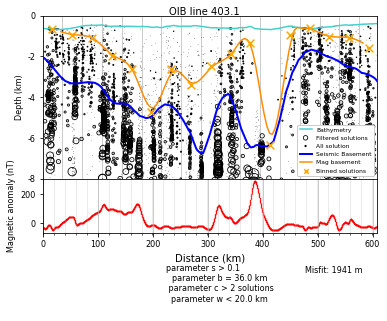

In [28]:
# choose line, and pick parameter values
plot_OIB(
    Line_oib=403.1,
    # Line_oib=403.3,
    oib_parameter_s=.1,
    oib_parameter_w=20000,
    oib_parameter_b=36000,
    oib_parameter_c=2, animation=False)

## 5) optimize parameters to match OIB to ANTOSTRAT basement

The above function *filt_and_binning_oib* takes an input of parameters w,s,b, and c, and returns a mean misfit between OIB and ANTOSTRAT basement. We now apply a wide range of these parameter values to this function to find which values result in the smallest misfit. First we set up an empty dataframe for all possible combinations of 21 values for each variable, then for each combination we apply *filt_and_binning_oib* and save the resulting misfit value. We do this for both line 403.1 and 403.3.

### Create optimization database
This will contain a column for each parameter. Each parameter will have 21 values, and the rows will be each unique combination of these parameter values. This results in a total of 194481 combinations.

In [ ]:
s=np.linspace(0, 4, 21)
w=np.linspace(0, 40000, 21, dtype=int)
b=np.linspace(0, 40000, 21, dtype=int)
c=np.linspace(0, 40, 21, dtype=int)
params=[s,w,b,c]         
comb=list(itertools.product(*params))   
df_misfit_oib=pd.DataFrame(comb, columns=['susc', 'window', 'bin', 'count'])

### Calculate misfit for each row
Apply the function *filt_and_binning_oib* to each row and save the results. Do this for both lines; 403.1 and 403.3.  
WARNING, THIS MAY TAKE SEVERAL HOURS TO RUN!

In [ ]:
from tqdm import tqdm
tqdm.pandas()
lines=[403.1, 403.3]
for l in lines:# look into replacing apply with vectorization
    df_misfit_oib['misfit_{}'.format(l)]=df_misfit_oib.progress_apply(lambda x: filt_and_binning_oib(Line_oib=l,  
                                oib_parameter_s=x['susc'], 
                                oib_parameter_w=x['window'], 
                                oib_parameter_b=x['bin'], 
                                oib_parameter_c=x['count']), axis=1)
df_misfit_oib.describe()

### Organize output data
For each row, take the average of the misfits for both 403.1 and 403.3.   
Sort by these average values and save as a csv.  
Drop erroneous first 4 rows. 

In [ ]:
# average the misfit of lines 403.1 and 403.3.
df_misfit_oib['misfit_oib_avg']=df_misfit_oib[['misfit_403.1', 'misfit_403.3']].dropna(subset=['misfit_403.1', 'misfit_403.3']).mean(axis=1)
# sort from lowest misfit to highest.
df_misfit_oib.sort_values('misfit_oib_avg', inplace=True)
# save as csv
df_misfit_oib.to_csv('data/results/mean_misfit_oib_optimize.csv', index=False)

In [29]:
# load file
df_mean_misfit_oib= pd.read_csv('data/results/mean_misfit_oib_optimize.csv', header=0, index_col=None, sep=',')
# drop first 4 rows; issues with too short of interpolated lines
df_mean_misfit_oib_clip=df_mean_misfit_oib[5::]
# reset index
df_mean_misfit_oib_clip.reset_index(inplace=True, drop=True)
df_mean_misfit_oib_clip.head()

,window,susc,bin,count,misfit_403.1,misfit_403.3,misfit_oib_avg
0,10000,1.0,36000,6,315.258891,1255.907938,785.583414
1,10000,1.0,24000,6,405.321583,1173.121948,789.221765
2,10000,0.8,24000,8,399.271366,1182.775795,791.023581
3,10000,0.8,18000,8,365.440901,1232.750867,799.095884
4,12000,0.8,24000,16,400.124279,1203.110580,801.617430


### Optimization results

Above are the top 5 sets of parameters which produced the best match between OIB to ANTOSTRAT basement models. We use the values in row 0 as our final optimized parameters.
These values include:
* parameter W: 10 km (maximum Werner window width)
* parameter S: 1.0 (minimum magnetic susceptibility x body width) 
* parameter B: 36 km (bin width)
* parameter C: 6 (minumum count of solutions / bin)

Using these parameters, we plot the resulting OIB basement solutions below, including for OIB line 404, over the Ross Ice Shelf

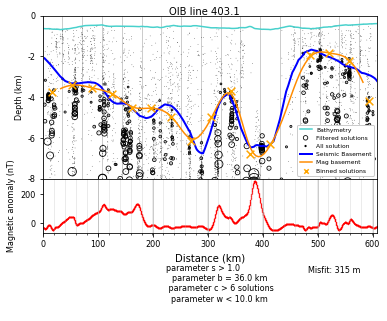

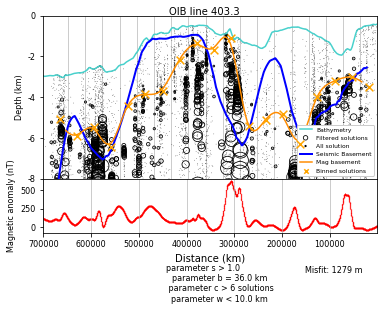

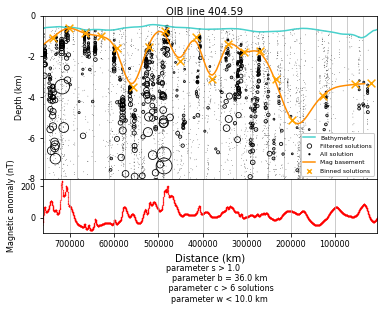

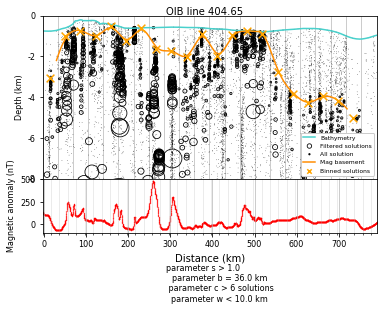

In [30]:
for line in (403.1, 403.3, 404.59, 404.65):     
        row = 0
        plot_OIB(Line_oib = line, 
                oib_parameter_s=df_mean_misfit_oib_clip['susc'].iloc[row], 
                oib_parameter_w=df_mean_misfit_oib_clip["window"].iloc[row], 
                oib_parameter_b=df_mean_misfit_oib_clip['bin'].iloc[row], 
                oib_parameter_c=df_mean_misfit_oib_clip['count'].iloc[row])

## Visualize optimization results
To visualize the optimization process, we will make animations for a random selection of parameter sets.

In [37]:
# sample the optimization database, getting 20 random rows
df_sample=df_mean_misfit_oib_clip[df_mean_misfit_oib_clip.misfit_oib_avg.notna()].sample(n=20)

s=np.array(df_sample['susc'])  
w=np.array(df_sample["window"])
b=np.array(df_sample['bin'])
c=np.array(df_sample['count'])

fig = plt.figure(facecolor='w', dpi=400)

def animate(i):
    plot_OIB(
        Line_oib=403.1,
        oib_parameter_s=s[i],
        oib_parameter_w=w[i],
        oib_parameter_b=b[i],
        oib_parameter_c=c[i], animation=True)
plt.close()
anim = matplotlib.animation.FuncAnimation(fig, animate, blit=False, frames=len(s), interval=400)
HTML(anim.to_jshtml())

<Figure size 432x288 with 0 Axes>

In [ ]:
# # seperate into files for each line, sort by misfit, and save original index.
# oib_403_1_misfit=df_mean_misfit_oib_clip.sort_values('misfit_403.1')
# oib_403_3_misfit=df_mean_misfit_oib_clip.sort_values('misfit_403.3')
# oib_403_1_misfit.reset_index(inplace=True)
# oib_403_3_misfit.reset_index(inplace=True)
# oib_403_1_misfit.rename(columns={'index':'old_index'}, inplace=True)
# oib_403_3_misfit.rename(columns={'index':'old_index'}, inplace=True)
# # find new index value for best averaged misfit, which was old_index 0
# print(oib_403_1_misfit[oib_403_1_misfit.old_index==0].index)
# print(oib_403_3_misfit[oib_403_3_misfit.old_index==0].index)
# # sample the optimization database, getting 20 rows, at 100 row increements, starting with the lowest avg. misfit
# start=920 # index 920 for 403.3 was index 0 for both 403.1 & 403.3
# stop=2_900
# inc=100
# s=np.array(oib_403_3_misfit['susc'][start:stop].iloc[::inc])  
# w=np.array(oib_403_3_misfit["window"][start:stop].iloc[::inc])
# b=np.array(oib_403_3_misfit['bin'][start:stop].iloc[::inc])
# c=np.array(oib_403_3_misfit['count'][start:stop].iloc[::inc])
# # reverse so animation ends with best misfit
# w=w[::-1]
# s=s[::-1]
# b=b[::-1]
# c=c[::-1]
# fig = plt.figure(facecolor='w', dpi=400)
# def animate(i):
#     plot_OIB(
#         Line_oib=403.3,
#         oib_parameter_s=s[i],
#         oib_parameter_w=w[i],
#         oib_parameter_b=b[i],
#         oib_parameter_c=c[i], animation=True)
# plt.close()
# anim = matplotlib.animation.FuncAnimation(fig, animate, blit=False, frames=len(s), interval=400)
# HTML(anim.to_jshtml())

## Recreate Figures 2 and S2
Now that we have finished the OIB-ANTOSTRAT optimization, lets recreate the figures from the manuscript. To do this, we need to change directories into the /Figures folder, and run the jupyter notebooks "Fig2_OIB_403_1.ipynb" and "FigS2_OIB_403_3.ipynb".

In [3]:
os.chdir('Figures')
os.getcwd()

'C:\\Users\\matthewt\\Documents\\Python_Scripts\\RIS_basement_sediment\\Figures'

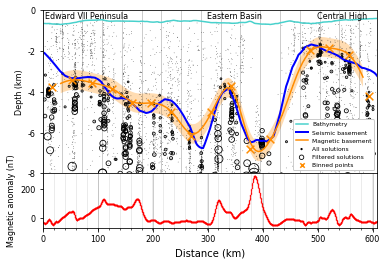

In [8]:
%run Fig2_OIB_403_1.ipynb

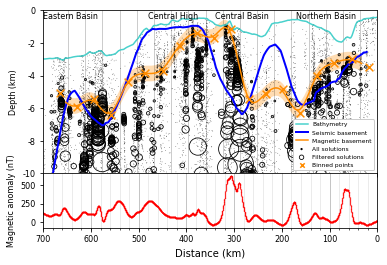

In [7]:
%run Fig_S2_OIB_403_3.ipynb

Now lets change back to the folder \RIS_basement_sediment

In [253]:
os.chdir('..')
os.getcwd()

'C:\\Users\\matthewt\\Documents\\Python_Scripts\\RIS_basement_sediment'

## 6) optimize parameters to match ROSETTA to OIB basement

Now that we have constrained basement depths for OIB flight 404 over the ice shelf (Figure 1b), we can "re-optimize" our parameters to be best suited for the ROSETTA-Ice magnetics data. This re-optimization is necessary due to differences between the OIB and ROSETTA magnetics data, including flight speed, elevation, sensors, aircraft, and processing. The filtering and binning process is the same as *filt_and_binning_oib*, but is implemented in a new function *filt_and_binning_rs*

In [ ]:
# make function for filtering Werner solutions on susceptibilty & window width, and bins results
def filt_and_binning_rs(Line_rs, rs_parameter_s, rs_parameter_w, rs_parameter_b, rs_parameter_c):
    global Line_oib, mean_misfit, median_misfit, rs_filt_with_centers, rs, rs_mag, Distance_name, Depth_name, rs_filt, rs_bin_centers, df_rs_basement, df_rs_oib_basement
    
    """
    Use optimize parameters on OIB lines
    """
    if Line_rs in [590,]:
        Line_oib=404.59
        filt_and_binning_oib(Line_oib=Line_oib,
                        oib_parameter_s=1,
                        oib_parameter_b=36000,
                        oib_parameter_w=10000, 
                        oib_parameter_c=6)
    elif Line_rs in [650,]:
        Line_oib=404.65
        filt_and_binning_oib(Line_oib=Line_oib,
                oib_parameter_s=1,
                oib_parameter_b=36000,
                oib_parameter_w=10000, 
                oib_parameter_c=6)
    else:
        mean_misfit=np.nan

    # isolate an individual line
    rs = df0_rs[df0_rs.Line==Line_rs].copy()
    rs_mag = df_mag[df_mag.Line==Line_rs]
    
    # need to do this after interp, before comparision
#     """
#     Reset distance column to be equal to OIB distances to allow comparision
#     """
#     if Line_rs == 590:
#         rs.rename(columns={'Distance':'Distance_rs'}, inplace=True)
#         rs_mag=rs_mag.rename(columns={'Distance':'Distance_rs'})
        
#         # set Distance to be relative to max values of oib dataset
#         oib_x_start=oib_mag.loc[oib_mag.Distance.idxmin()].x #335937.8 m
#         oib_y_start=oib_mag.loc[oib_mag.Distance.idxmin()].y #-1035932.8 m
#         rs['Distance'] = np.sqrt((rs.x-oib_x_start)**2 + (rs.y-oib_y_start)**2)
#         rs_mag['Distance'] = np.sqrt((rs_mag.x-oib_x_start)**2 + (rs_mag.y-oib_y_start)**2)
        
#         # remove values outside range of oib (from oib max dist to min dist)
#         rs =         rs [    rs.x.between(oib_mag.loc[oib_mag.Distance.idxmax()].x, oib_mag.loc[oib_mag.Distance.idxmin()].x)]
#         rs_mag = rs_mag [rs_mag.x.between(oib_mag.loc[oib_mag.Distance.idxmax()].x, oib_mag.loc[oib_mag.Distance.idxmin()].x)]
#     elif Line_rs == 650:
#         rs.rename(columns={'Distance':'Distance_rs'}, inplace=True)
#         rs_mag=rs_mag.rename(columns={'Distance':'Distance_rs'})
    
#         # set Distance to be relative to max values of oib dataset
#         oib_x_start=oib_mag.loc[oib_mag.Distance.idxmin()].x #-469761 m 
#         oib_y_start=oib_mag.loc[oib_mag.Distance.idxmin()].y #-1087065.5 m
#         rs['Distance'] = np.sqrt((rs.x-oib_x_start)**2 + (rs.y-oib_y_start)**2)
#         rs_mag['Distance'] = np.sqrt((rs_mag.x-oib_x_start)**2 + (rs_mag.y-oib_y_start)**2)
        
#         # remove values outside range of oib (from oib min dist to max dist)
#         rs =         rs [    rs.x.between(oib_mag.loc[oib_mag.Distance.idxmin()].x, oib_mag.loc[oib_mag.Distance.idxmax()].x)]
#         rs_mag = rs_mag [rs_mag.x.between(oib_mag.loc[oib_mag.Distance.idxmin()].x, oib_mag.loc[oib_mag.Distance.idxmax()].x)]    
#     else:
#         pass
    
    # retain rs dataframe before filtering is applied
    rs_filt=copy.deepcopy(rs)

    # sample gridded basement onto dataframe
    rs = rs[ ['y'] + [ col for col in rs.columns if col != 'y' ] ]
    rs = rs[ ['x'] + [ col for col in rs.columns if col != 'x' ] ]
    rs = pygmt.grdtrack(points=rs, 
                        grid='Data/rosetta_lindeque_basement_g80kfilt.nc', 
                        newcolname='Data/rosetta_lindeque_basement_g80kfilt.nc')
    
    """
    filter solutions based on susceptibility and window width
    add filtered solutions depths and distances to new columns
    i.e. Distance_36k and Depth_36k for iterations where b=36km
    """
    Distance_name = 'Distance_'+(str(int(rs_parameter_b/1000))+'k')
    Depth_name ='Depth_'+(str(int(rs_parameter_b/1000))+'k')
    rs_filt = pd.concat([rs_filt,pd.DataFrame(columns=[Distance_name, Depth_name])]) # add above columns to rs
    rs_filt[Distance_name] = np.floor(rs_filt.Distance[(rs_filt.Susc > rs_parameter_s) & 
                                                       (rs_filt.Window_Width < rs_parameter_w)]/rs_parameter_b)*rs_parameter_b 
    rs_filt[Depth_name] = rs_filt.Depth[(rs_filt.Susc > rs_parameter_s) & (rs_filt.Window_Width < rs_parameter_w)]
    rs_filt.dropna(inplace=True) # remove rows with NaNs

    # Set bin centers equal to 95% depth of solutions within bin
    def quant(x):
        return x.quantile(0.95)
    # new df with only binned points, with distances set to the center of the bins and depths set to 95% of all points within bins
    rs_bin_centers = rs_filt.groupby([Distance_name], as_index=False).agg({Depth_name: quant})
    rs_bin_centers['Distance'] = rs_bin_centers[Distance_name]+(rs_parameter_b/2)
    rs_bin_centers['binned']=1 # keep track of binned points

    # rename Depth_name column so rs_bin_centers can be merged
    rs_filt.rename(columns={Depth_name:'Depth_filtered'}, inplace=True)

    # add the binned solutions to rs_filt
    rs_filt_with_centers = rs_filt.set_index(['Distance', Distance_name]).join(rs_bin_centers.set_index(['Distance', Distance_name]), how='outer')
    rs_filt_with_centers.reset_index(inplace=True)
    rs_filt_with_centers.sort_values(['Distance'], inplace=True)
    #fill nan's in columns, except 'binned'
    for col in rs_filt_with_centers.columns:
        if col == 'binned':
            pass
        else:
            rs_filt_with_centers[col].interpolate(method='linear', limit_direction='both', inplace=True)    

    """
    retain only the bins which contain a minumum number (count) of points
    """
    # number of filtered points within each bin
    rs_filt_with_centers['counts'] = rs_filt_with_centers.groupby([Distance_name])['Depth_filtered'].transform('count')
    rs_bin_centers=rs_filt_with_centers[rs_filt_with_centers.binned.notna()]
    rs_bin_centers=rs_bin_centers[rs_bin_centers.counts>rs_parameter_c]
       
    """
    Compare rs basement results with ANTOSTRAT basement results
    interpolate line between binned points for comparison with ANTOSTRAT
    """
    try:
        x1 = min(rs_bin_centers.Distance)
        x2 = max(rs_bin_centers.Distance)
        increment = 5000  #sample every 5k for optimization, every 1km of uncertainty analysis
        Distance_new = np.arange(x1, x2, increment)  # creates array for distance to interpolate onto, 1 point every 5km
        window = int(30000/increment) # window size for filtering resulting interpolated line
        # define function which takes distance, and gives interpolated depths
        f = scipy.interpolate.interp1d(rs_bin_centers.Distance, rs_bin_centers[Depth_name], kind='quadratic', 
                                       fill_value='extrapolate') 
        # apply function to new distance array
        rs_basement=f(Distance_new)  
        # add new distances and interpolated depth to dataframe
        rs_solutions=pd.DataFrame(data={'Distance':Distance_new, 'rs_basement':rs_basement})
        # smooth the interpolated depths with a rolling mean window 
        rs_solutions['rs_basement_filt'] = rs_solutions.rs_basement.rolling(window, center=True).mean()
        rs_solutions.sort_values(['Distance'], inplace=True)
        # add 'rs_basement' and 'rs_basement_filt' columns to database to get x, y, etc. 
        df_rs_basement=rs_filt_with_centers.set_index('Distance').join(rs_solutions.set_index('Distance'), how='outer')
        df_rs_basement.reset_index(inplace=True)
        df_rs_basement.sort_values(['Distance'], inplace=True)
        # fill nans in all columns except 'rs_basement_filt' to get x, y, etc. for interpolated basement line
        for col in df_rs_basement.columns:
            if col == 'rs_basement_filt':
                pass
            else:
                df_rs_basement[col].interpolate(method='linear', limit_area='inside', inplace=True)    
        # drop all rows except for interpolate basement line
        # df_rs_basement.dropna(inplace=True)
        df_rs_basement.dropna(subset=['rs_basement_filt'], inplace=True)
        # if solutions are shallower then bathymetry, set equal to bathymetry

        df_rs_basement['filt_clip'] = np.where(df_rs_basement.rs_basement_filt>df_rs_basement.bedmap2_bed,
                                                    df_rs_basement.bedmap2_bed, df_rs_basement.rs_basement_filt)
        
        """
        Reset distance column to be equal to OIB distances to allow comparision
        """
        if Line_rs == 590:
            df_rs_basement_redist=df_rs_basement.rename(columns={'Distance':'Distance_rs'})

            # set Distance to be relative to max values of oib dataset
            oib_x_start=oib_mag.loc[oib_mag.Distance.idxmin()].x #335937.8 m
            oib_y_start=oib_mag.loc[oib_mag.Distance.idxmin()].y #-1035932.8 m
            df_rs_basement_redist['Distance'] = np.sqrt((df_rs_basement_redist.x-oib_x_start)**2 + (df_rs_basement_redist.y-oib_y_start)**2)

            # remove values outside range of oib (from oib max dist to min dist)
            df_rs_basement_redist = df_rs_basement_redist [df_rs_basement_redist.x.between(oib_mag.loc[oib_mag.Distance.idxmax()].x, oib_mag.loc[oib_mag.Distance.idxmin()].x)]
        elif Line_rs == 650:
            df_rs_basement_redist=df_rs_basement.rename(columns={'Distance':'Distance_rs'})

            # set Distance to be relative to max values of oib dataset
            oib_x_start=oib_mag.loc[oib_mag.Distance.idxmin()].x #-469761 m 
            oib_y_start=oib_mag.loc[oib_mag.Distance.idxmin()].y #-1087065.5 m
            df_rs_basement_redist['Distance'] = np.sqrt((df_rs_basement_redist.x-oib_x_start)**2 + (df_rs_basement_redist.y-oib_y_start)**2)

            # remove values outside range of oib (from oib min dist to max dist)
            df_rs_basement_redist = df_rs_basement_redist [df_rs_basement_redist.x.between(oib_mag.loc[oib_mag.Distance.idxmin()].x, oib_mag.loc[oib_mag.Distance.idxmax()].x)]
        else:
            pass
        
        """
        
        
        NEED TO RESET DISTANCES 
        
        
        """
        
        """
        if line 590 or 650, compare resulting interpolated line with coincident OIB basement 
        """
        if Line_rs in [590, 650]:
            df_oib_basement.rename(columns={'filt_clip':'filt_clip_oib'}, inplace=True)
            # add oib interpolated basement into df_rs_basement dataframe based on distance column
            df_rs_oib_basement=df_rs_basement.set_index('Distance').join(df_oib_basement.set_index('Distance').filt_clip_oib, how='outer')
            # remove distance from index
            df_rs_oib_basement.reset_index(inplace=True)
            df_rs_oib_basement['misfit'] = df_rs_oib_basement.filt_clip_oib - df_rs_oib_basement.filt_clip 
            df_rs_oib_basement['abs_misfit'] = np.abs(df_rs_oib_basement.misfit)
            mean_misfit=df_rs_oib_basement.abs_misfit.mean()
            median_misfit=df_rs_oib_basement.abs_misfit.median()
        else:
            mean_misfit=np.nan
            median_misfit=np.nan
    except: 
        mean_misfit=np.nan
        median_misfit=np.nan
     # if more than 2 solution per 100km than continue  
    try:
        if (len(rs_bin_centers))/((max(rs_filt_with_centers.Distance)-min(rs_filt_with_centers.Distance))/100_000)<2: 
            mean_misfit=np.nan 
            median_misfit=np.nan
        else:
            pass
    except:
        pass
    return mean_misfit

In [ ]:
"""
erase any leftover global variables from above function
"""
vars=('mean_misfit','median_misfit','rs_filt_with_centers','rs','rs_mag','Distance_name','Depth_name',
      'rs_filt','rs_bin_centers','df_rs_basement','df_rs_oib_basement',)
save_list = globals() # list of all variables
save_list = [k for k in save_list if k not in vars]# all variables except thos in vars
# #finally, clear all variables (except default and saved) with:
for name in dir():
    if name not in save_list:
        del globals()[name]
# for name in globals():
#     if name not in save_list:
#         del locals()[name] 

"""
plotting function
"""
def plot_ROSETTA(Line_rs, rs_parameter_s, rs_parameter_w, rs_parameter_b,  rs_parameter_c):
    # run above function with parameters
    filt_and_binning_rs(Line_rs, rs_parameter_s, rs_parameter_w, rs_parameter_b,  rs_parameter_c)
    
    # initialize figure
    fig = plt.figure()
    gs = gridspec.GridSpec(2,1, height_ratios=[3,1])
    ax0 = fig.add_subplot(gs[0])
    
    # bedmap2 bathymetry
    ax0.plot(rs.Distance, rs.bedmap2_bed, c='mediumturquoise', 
             linewidth=1.5, label='Bathymetry')
    
    # ROSETTA filtered solutions, scaled by Susc
    ax0.scatter(rs_filt.Distance, rs_filt.Depth, s = rs_filt.Susc*3, marker='o', 
                edgecolors='k', facecolors='none', linewidth=.8, label='Filtered solutions')
    
    # ROSETTA Werner dike solutions 
    ax0.scatter(rs.Distance, rs.Depth, s = 1.5, marker='.', edgecolor='none', 
                facecolor='k', label='All solution')
    
 
    if Line_rs in [590, 650]:
        # OIB basement 
        ax0.plot(df_oib_basement.Distance, df_oib_basement.filt_clip_oib,  c='blue', 
                 linewidth=2, label='OIB Basement')
    else:
        # ROSETTA sampled gridded basement
        ax0.plot(rs.Distance[rs['Data/rosetta_lindeque_basement_g80kfilt.nc'].notna()], 
                 rs['Data/rosetta_lindeque_basement_g80kfilt.nc'][rs['Data/rosetta_lindeque_basement_g80kfilt.nc'].notna()], 
                 c='b', label='Gridded Mag basement')

    try:
        # interpolated ROSETTA basement
        ax0.plot(df_rs_basement.Distance, df_rs_basement.filt_clip, 
             linewidth=2, c='darkorange', label='Magnetic basement')   
    except: 
        pass
    
    # binned ROSETTA basement solutions
    ax0.scatter(rs_bin_centers.Distance, rs_bin_centers[Depth_name], marker='X', 
                c='darkorange', s=80, edgecolors='k', linewidth=.5, label='Binned solutions', zorder=15)
    
    if Line_rs in [590, 650]:
        ### ROSETTA magnetics    
        ax1 = fig.add_subplot(gs[1], sharex=ax0)
        ax1.scatter(rs_mag.Distance, rs_mag.Mag_anom_draped_1000, 
                    s=.05, c='magenta', label='ROSETTA')
        #### OIB magnetics
        ax3 = fig.add_subplot(gs[1],  sharex=ax0)
        ax3.patch.set_alpha(0)
        ax3.scatter(oib_mag.Distance, oib_mag.Mag_anom_draped_1000, 
                    s=.05, c='k', label='OIB')
        ax3.yaxis.tick_left()
        ax3.tick_params(axis='both', labelsize=8)
        ax3.set_ylabel('Magnetic anomaly (nT)', size=8, labelpad=10)
        ax1.annotate(text='OIB', xy=(0.01,0.8), xycoords='axes fraction', fontsize=6)    
        ax1.annotate(text='ROSETTA', xy=(0.01,0.9), xycoords='axes fraction', 
                 fontsize=6, color='magenta')
        ax1.tick_params(axis='both', labelsize=8)
        ax1.tick_params(axis='y', labelsize=8, colors='magenta', pad=0)
        ax0.tick_params(axis='both', labelsize=8)
    else:    
        # ROSETTA magnetics  
        ax1 = fig.add_subplot(gs[1], sharex=ax0)
        ax1.scatter(oib_mag.Distance, oib_mag.Mag_anom_draped_1000, s=.05, 
                    c='r', label='ROSETTA')
        ax1.yaxis.set_label_position("left")
        ax1.set_ylabel('Magnetic anomaly (nT)', size=8)
        

    if Line_rs==590:
        ax0.text(x=-100000, y=-400, s='Mid-Shelf High', fontsize=8)
        ax0.text(x=150000, y=-400, s='Western Ross Basin', fontsize=8)
    elif Line_rs==650:
        ax0.text(x=-350000, y=-400, s='Roosevelt Island', fontsize=8)
        ax0.text(x=-120000, y=-400, s='Mid-Shelf High', fontsize=8)
        ax0.text(x=100000, y=-400, s='Western Ross Basin', fontsize=8)
    else:
        pass

    ax1.yaxis.tick_left()
    ax1.tick_params(axis='both', labelsize=8)
    ax0.tick_params(axis='both', labelsize=8)
    
    if Line_rs == 650:
        ax1.set_yticks(ticks=(-900,-1100))
    else:
        pass
        
    # set ticks / limits
    # reverse x axis if flight is West to East
    if rs.Distance[rs.x.idxmin()] > rs.Distance[rs.x.idxmax()]:
        ax1.set_xlim(rs.Distance.max(), rs.Distance.min()) 
        ax1.set_xticks(np.arange(rs.Distance.min(), rs.Distance.max(), 100000))
        ax1.set_xticklabels(np.arange(0, int((rs.Distance.max())/1000), 100))
        ax1.set_xticks(np.arange(0, int((rs.Distance.max())), 20000), minor=True)
    else:
        ax1.set_xlim(rs.Distance.min(), rs.Distance.max())
        ax1.set_xticks(np.arange(rs.Distance.min(), rs.Distance.max(), 100000))
        ax1.set_xticklabels(np.arange(0, int((rs.Distance.max())/1000), 100))
        ax1.set_xticks(np.arange(0, int((rs.Distance.max())), 20000), minor=True)

    ax0.set_ylim(-10000, 0)
    ax0.set_yticks((-8000, -6000, -4000, -2000, 0))
    ax0.set_yticklabels((-8, -6, -4, -2, 0))

    ax0.grid(axis='x', which='major', alpha=0.8)
    ax0.grid(axis='x', which='minor', alpha=0.3)
    ax1.grid(axis='x', which='major', alpha=0.8)
    ax1.grid(axis='x', which='minor', alpha=0.3)
    ax0.set_ylabel('Depth (km)', size=8)
    ax1.set_xlabel('Easting (km)', size=8)

    lgnd = ax0.legend(loc='lower right', fontsize=6, markerscale=4,framealpha=1)
    lgnd.legendHandles[-5]._sizes = [20]
    lgnd.legendHandles[-4]._sizes = [20]
    lgnd.legendHandles[-3]._sizes = [20]
    lgnd.legendHandles[-2]._sizes = [20]
    lgnd.legendHandles[-1]._sizes = [20]
    
    if Line_rs in [590, 650]:
        ax0.set_title('ROSETTA Line '+str(Line_rs)+' / OIB Line '+str(Line_oib))
    else:
        ax0.set_title('ROSETTA Line '+str(Line_rs))

    fig.subplots_adjust(hspace=0)
    plt.setp(ax0.get_xticklabels(),visible=False)
    plt.show()

In [ ]:
plot_ROSETTA(Line_rs=650,
            rs_parameter_s=1.2, 
            rs_parameter_w=26_000, 
            rs_parameter_b =36_000, 
            rs_parameter_c=40)

In [ ]:
median_misfit

## Filtering / binning of ROSETTA data
This figure shows an example of our tie between OIB and ROSETTA magnetic basements, implemented with the two above functions: *filt_and_binning_rs* and *plot_ROSETTA*. It is similar to OIB-ANTOSTRAT figure above, but now ANTOSTRAT basement (blue) has been replaced by OIB magnetic basement. The x axis now easting, instead of distance. 

* bathymetry in light blue at the top
* OIB magnetic basement in dark blue
* airborne magnetic data in the lower panel, pink for ROSETTA and black for OIB
* small black dots show the "depth scatter" of dike solutions from Werner deconvolution, performed in *Oasis Montaj*
* black circles show filtered Werner solutions, scaled to parameter S
     * filtering based on parameter S and W (magnetic susceptibilty*width and Werner window width, respectively) 
* orange crosses show bins with sufficient count of points (paramter c)
     * crosses set to center of bins, and depth's set to 95% of solution depths within bin
* orange line shows interpolation between crosses, used to compare between ROSETTA and OIB

## Optimization of OIB to ANTOSTRAT basement

Same as the OIB-ANTOSTRAT tie, the above function *filt_and_binning_rs* has and input of parameters w,s,b, and c, and returns a mean misfit between ROSETTA and OIB basements. We perform the same optimization as above.

In [ ]:
# create dataframe with all possible combinations of 21 values for each parameter
# total 194481 combos
s=np.linspace(0, 4, 3)
w=np.linspace(0, 40000, 3, dtype=int)
b=np.linspace(0, 40000, 3, dtype=int)
c=np.linspace(0, 40, 3, dtype=int)
params=[s,w,b,c]         
comb=list(itertools.product(*params))   
df_misfit_rs=pd.DataFrame(comb, columns=['susc', 'window', 'bin', 'count'])

In [ ]:
# apply the function to each row of the above parameter database, for both line segments.
# WARNING, this cell will likely take several hours to run.
from tqdm import tqdm
tqdm.pandas()

lines=[590, 650]
# look into replacing apply with vectorization
for l in lines:
    df_misfit_rs['misfit_{}'.format(l)]=df_misfit_rs.progress_apply(lambda x: filt_and_binning_rs(Line_rs=l,  
                                rs_parameter_s=x['susc'], 
                                rs_parameter_w=x['window'], 
                                rs_parameter_b=x['bin'], 
                                rs_parameter_c=x['count']), axis=1)
df_misfit_rs.describe()

In [ ]:
df_misfit_rs

In [ ]:
# average the misfit of lines 403.1 and 403.3.
df_misfit_rs['misfit_rs_avg']=df_misfit_rs[['misfit_590', 'misfit_650']].dropna(subset=['misfit_590', 'misfit_650']).mean(axis=1)
# sort from lowest misfit to highest.
df_misfit_rs.sort_values('misfit_rs_avg', inplace=True)
# save as csv
# df_misfit_rs.to_csv('mean_misfit_rs_optimize.csv', index=False)

In [ ]:
# load file
df_mean_misfit_rs= pd.read_csv('mean_misfit_rs_optimize.csv', header=0, index_col=None, sep=',')

In [ ]:
df_mean_misfit_rs[0:10]

## Optimization results

Above are the 10 sets of parameters which produced the ROSETTA basement solutions with the lowest mean misfit to ANTOSTRAT. We have chosen row 5 as the optimal parameter values.  
This values include:
* parameter W: maximum Werner window with of 10 km
* parameter S: minimum magnetic susceptibiltiy*width of 1.0
* parameter B: bin width of 36 km
* parameter C: minumum count of solutions / bin of 6

Using these parameters, we plot the resulting ROSETTA basement solutions, including for ROSETTA line 404, over the Ross Ice Shelf

In [ ]:
for line in (590, 650):     
        row = 5 # in : 0,1,2 are short segments, 3,4,5 are good, 5 is what we settled on.
        plot_ROSETTA(Line_rs = line, 
              rs_parameter_w=df_mean_misfit_rs["window"].iloc[row], 
              rs_parameter_s=df_mean_misfit_rs['susc'].iloc[row], 
              rs_parameter_b=df_mean_misfit_rs['bin'].iloc[row], 
              rs_parameter_c=df_mean_misfit_rs['count'].iloc[row])